# 1.  Otomatik Araç Plaka Tespiti Algoritması

In [3]:
# Author: Umut Mehmet ERDEM - 2024

import cv2
import numpy as np
import matplotlib.pyplot as plt

# Görüntünün standart sapmasını hesaplayan fonksiyon
def calculate_std_dev(image):
    return np.std(image)

# İki dikdörtgen bölgenin kesişim yüzdesini hesaplayan fonksiyon
def compare_regions(region1, region2):
    x1, y1, w1, h1 = region1  # İlk bölgenin koordinatları ve boyutları
    x2, y2, w2, h2 = region2  # İkinci bölgenin koordinatları ve boyutları

    # Kesişimin sol üst ve sağ alt köşelerini hesaplama
    xi1 = max(x1, x2)
    yi1 = max(y1, y2)
    xi2 = min(x1 + w1, x2 + w2)
    yi2 = min(y1 + h1, y2 + h2)

    # Eğer kesişim yoksa sıfır döndür
    if xi1 >= xi2 or yi1 >= yi2:
        return 0

    # Kesişim alanını hesapla
    intersection_area = (xi2 - xi1) * (yi2 - yi1)

    # Her iki bölgenin alanlarını hesapla
    area1 = w1 * h1
    area2 = w2 * h2

    # Minimum alana göre kesişim yüzdesini hesapla
    overlap_percentage = intersection_area / min(area1, area2) * 100
    return overlap_percentage

# Araç plaka tespiti yapan fonksiyon
def licence_plate_detection(image_path):
    # Görüntüyü oku
    image = cv2.imread(image_path)
    # Görüntüyü gri tonlamaya çevir
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Top-hat dönüşümü için yapısal eleman oluştur ve Top-Hat dönüşümü uygula
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (30, 30))
    tophat_image = cv2.morphologyEx(gray_image, cv2.MORPH_TOPHAT, kernel)

    # Otsu eşikleme uygulayarak görüntüyü ikili hale getir
    _, otsu_thresh = cv2.threshold(tophat_image, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    # Kenar tespiti için Canny algoritmasını kullan
    edges = cv2.Canny(otsu_thresh, 100, 200)

    # Otsu ve Canny sonuçlarından konturları bul
    contours_otsu, _ = cv2.findContours(otsu_thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    contours_canny, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Konturlardan dikdörtgenler oluştur
    rects_otsu = [cv2.boundingRect(contour) for contour in contours_otsu]
    rects_canny = [cv2.boundingRect(contour) for contour in contours_canny]

    # İlgili indeksleri ve bayrağı başlat
    index_otsu = []
    index_canny = []
    flag = False
    rect_image = np.copy(image)  # Görüntü üzerinde işaretlemeler yapılacak kopya
    # Standart sapma parametreleri
    std_dev1 = 0
    std_dev2 = 0

    # Otsu konturlarını döngüyle işleme
    for rect1 in rects_otsu:
        x1, y1, w1, h1 = rect1
        # Plaka boyutlarına uymayan dikdörtgenleri filtrele
        if w1 < 90 or h1 < 35 or w1 / h1 < 1.75 or w1 / h1 > 4.6:
            continue

        # Bölgeyi çıkar ve histogram eşitlemesi uygula
        roi1 = gray_image[y1:y1 + h1, x1:x1 + w1]
        roi1_equalized = cv2.equalizeHist(roi1)

        # Standart sapmayı hesapla
        std_dev1 = calculate_std_dev(roi1_equalized)

        # Standart sapma uygun değilse geç
        if not (73.60 < std_dev1 < 74.60):
            continue
        
        index_otsu.append(rects_otsu.index(rect1))

        # Canny konturlarını döngüyle işleme
        for rect2 in rects_canny:
            x2, y2, w2, h2 = rect2
            # Plaka boyutlarına uymayan dikdörtgenleri filtrele
            if w2 < 90 or h2 < 35 or w2 / h2 < 1.75 or w2 / h2 > 4.6:
                continue

            if rects_canny.index(rect2) not in index_canny:
                index_canny.append(rects_canny.index(rect2))

            # İki dikdörtgenin kesişim yüzdesini hesapla
            overlap = compare_regions(rect1, rect2)

            # Kesişim oranı %70'ten büyükse işlemleri gerçekleştir
            if overlap > 70:
                roi2 = gray_image[y2:y2 + h2, x2:x2 + w2]
                roi2_equalized = cv2.equalizeHist(roi2)

                # Standart sapmayı hesapla
                std_dev2 = calculate_std_dev(roi2_equalized)

                # Uygunluk durumunda sonuçları göster
                if 73.60 < std_dev2 < 74.60:
                    flag = True
                    cv2.rectangle(rect_image, (x1, y1), (x1 + w1, y1 + h1), (0, 255, 0), 2)
                    cv2.rectangle(rect_image, (x2, y2), (x2 + w2, y2 + h2), (0, 255, 255), 2)

                    # Bilgileri ekrana yazdır
                    print(f"Otsu ROI (w, h, w/h): {w1}, {h1}, {w1/h1}, Std Dev: {std_dev1:.2f}")
                    print(f"Canny ROI (w, h, w/h): {w2}, {h2}, {w2/h2}, Std Dev: {std_dev2:.2f}")
                    print(f"Overlap: {overlap:.2f}%")

                    # Otsu ve Canny bölgelerini göster
                    plt.figure(figsize=(5, 5))
                    plt.subplot(1, 2, 1), plt.title("Otsu ROI"), plt.imshow(roi1, cmap='gray'), plt.axis("off")
                    plt.subplot(1, 2, 2), plt.title("Canny ROI"),plt.imshow(roi2, cmap='gray'), plt.axis("off")
                    plt.show()

        # Eğer hiçbir plaka bulunamadıysa durumları göster
        if not flag:
            if len(index_otsu) == 1:
                x1, y1, w1, h1 = rects_otsu[index_otsu[0]]
                print(f"Otsu ROI (w, h, w/h): {w1}, {h1}, {w1/h1}, Std Dev: {std_dev1:.2f}")
                roi1 = gray_image[y1:y1 + h1, x1:x1 + w1]
                plt.title("Otsu ROI"), plt.imshow(roi1, cmap='gray'), plt.axis("off"), plt.show()
            if len(index_canny) == 1:
                x2, y2, w2, h2 = rects_canny[index_canny[0]]
                print(f"Canny ROI (w, h, w/h): {w2}, {h2}, {w2/h2}, Std Dev: {std_dev2:.2f}")
                roi2 = gray_image[y2:y2 + h2, x2:x2 + w2]
                plt.title("Canny ROI"), plt.imshow(roi2, cmap='gray'), plt.axis("off"),plt.show()
    
    rect_image = cv2.cvtColor(rect_image, cv2.COLOR_BGR2RGB)

    # Tüm sonuçları farklı adımlarla göster
    fig, ax = plt.subplots(2, 3, figsize=(7, 5))
    ax[0, 0].set_title("Original Image"),      ax[0, 0].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB)),   ax[0, 0].axis('off')
    ax[0, 1].set_title("Gray Image"),          ax[0, 1].imshow(gray_image, cmap='gray'),                  ax[0, 1].axis('off')
    ax[0, 2].set_title("Top Hat Image"),       ax[0, 2].imshow(tophat_image, cmap='gray'),                ax[0, 2].axis('off')
    ax[1, 0].set_title("Otsu Thresholding"),   ax[1, 0].imshow(otsu_thresh, cmap='gray'),                 ax[1, 0].axis('off')
    ax[1, 1].set_title("Canny Edge Detection"),ax[1, 1].imshow(edges, cmap='gray'),                       ax[1, 1].axis('off')
    ax[1, 2].set_title("Bounding Box"),        ax[1, 2].imshow(rect_image),                               ax[1, 2].axis('off')
    plt.tight_layout(), plt.show()

## 1.1.  Eğitim Verileri için Plaka Tespiti

Otsu ROI (w, h, w/h): 293, 64, 4.578125, Std Dev: 74.12
Canny ROI (w, h, w/h): 293, 64, 4.578125, Std Dev: 74.12
Overlap: 100.00%


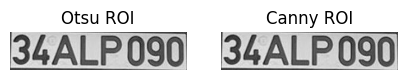

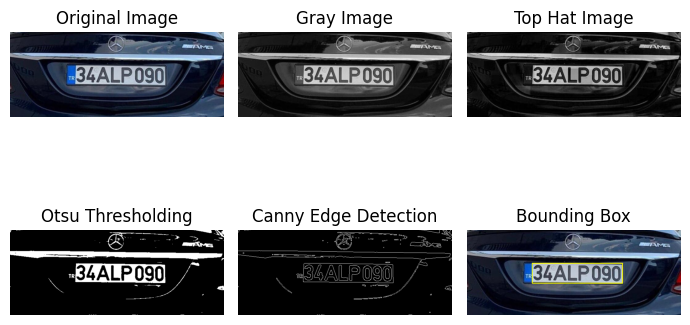

Otsu ROI (w, h, w/h): 152, 46, 3.3043478260869565, Std Dev: 74.33
Canny ROI (w, h, w/h): 152, 43, 3.5348837209302326, Std Dev: 74.32
Overlap: 97.03%


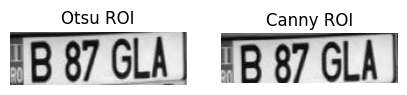

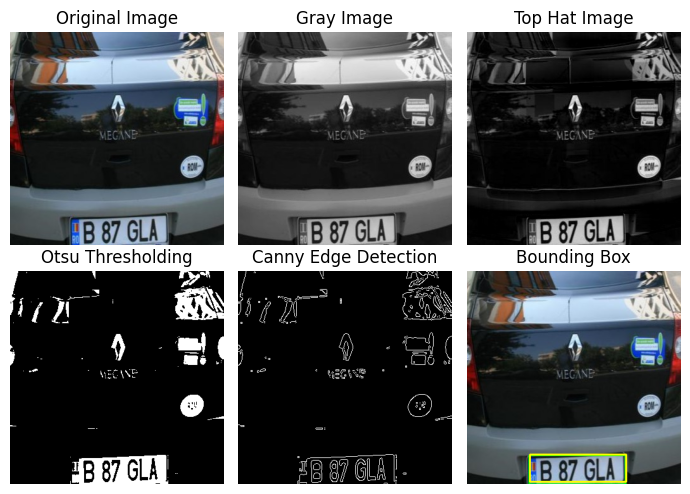

Otsu ROI (w, h, w/h): 132, 49, 2.693877551020408, Std Dev: 73.71
Canny ROI (w, h, w/h): 133, 50, 2.66, Std Dev: 73.73
Overlap: 100.00%


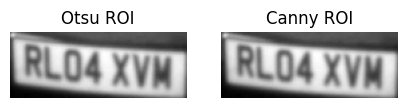

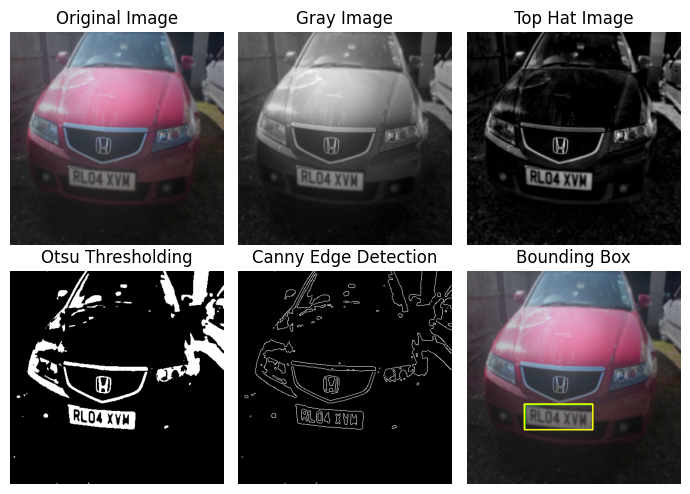

Otsu ROI (w, h, w/h): 207, 67, 3.08955223880597, Std Dev: 74.37
Canny ROI (w, h, w/h): 197, 64, 3.078125, Std Dev: 74.47
Overlap: 97.44%


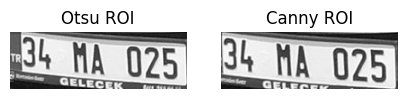

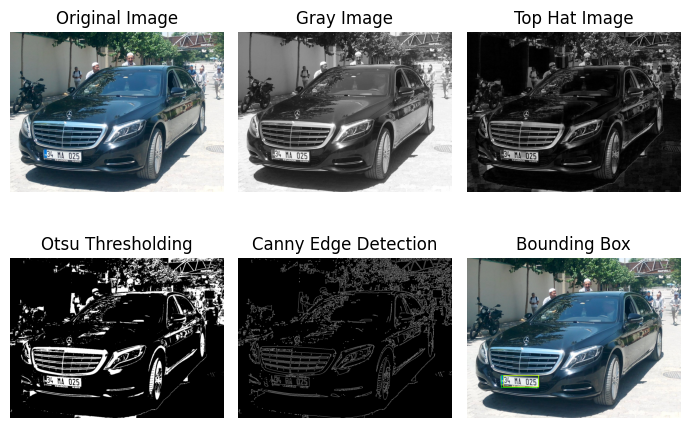

Otsu ROI (w, h, w/h): 298, 99, 3.01010101010101, Std Dev: 73.98
Canny ROI (w, h, w/h): 93, 48, 1.9375, Std Dev: 74.19
Overlap: 100.00%


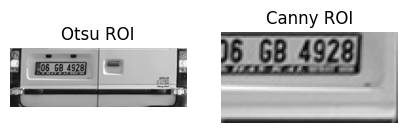

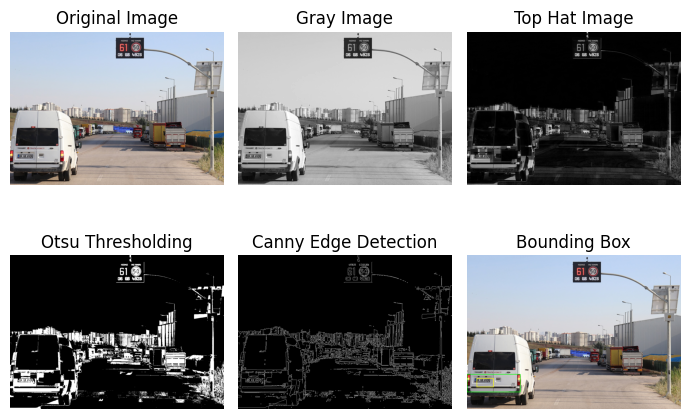

Otsu ROI (w, h, w/h): 125, 51, 2.450980392156863, Std Dev: 73.83


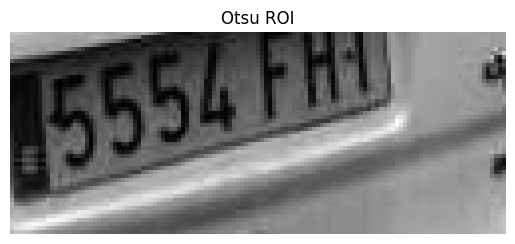

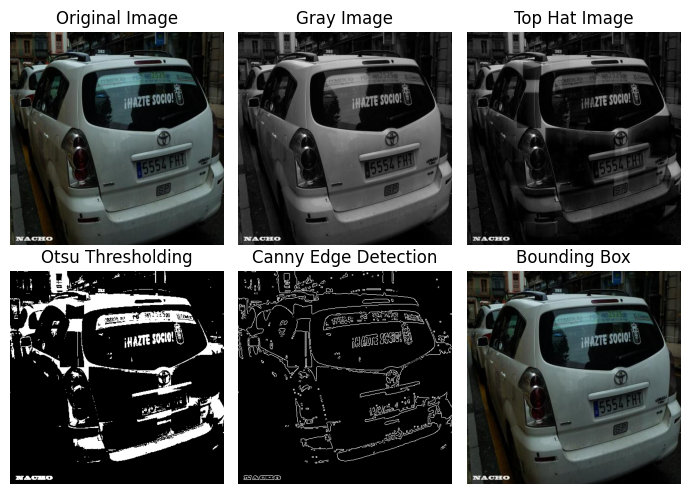

In [4]:
# Eğitim görüntüleri listesi
images = ["plate_traine_easy1.jpg", "plate_traine_easy2.jpg", "plate_traine_medium1.jpg", "plate_traine_medium2.jpg", "plate_traine_hard1.jpg", "plate_traine_hard2.jpg"]
# Her görüntüyü sırayla test et
for i in images:
    trace_image_path = f"images/{i}"
    licence_plate_detection(trace_image_path)

## 1.2.  Test Verileri için Plaka Tespiti

Otsu ROI (w, h, w/h): 128, 73, 1.7534246575342465, Std Dev: 74.31
Canny ROI (w, h, w/h): 132, 73, 1.8082191780821917, Std Dev: 74.29
Overlap: 100.00%


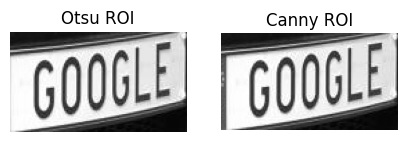

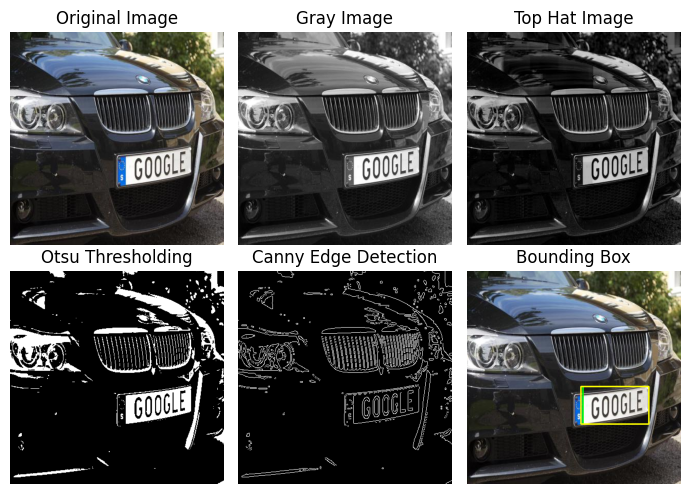

Otsu ROI (w, h, w/h): 132, 44, 3.0, Std Dev: 74.28
Canny ROI (w, h, w/h): 135, 45, 3.0, Std Dev: 74.25
Overlap: 100.00%


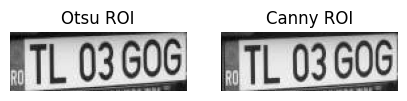

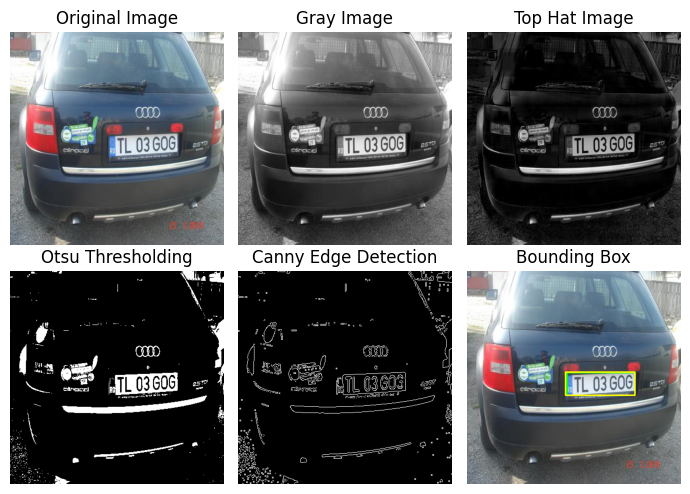

Otsu ROI (w, h, w/h): 123, 39, 3.1538461538461537, Std Dev: 73.61
Canny ROI (w, h, w/h): 116, 35, 3.3142857142857145, Std Dev: 73.75
Overlap: 97.14%


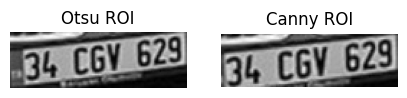

Otsu ROI (w, h, w/h): 127, 40, 3.175, Std Dev: 73.66
Canny ROI (w, h, w/h): 119, 40, 2.975, Std Dev: 73.73
Overlap: 100.00%


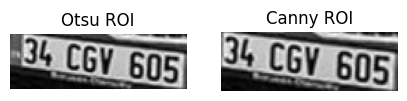

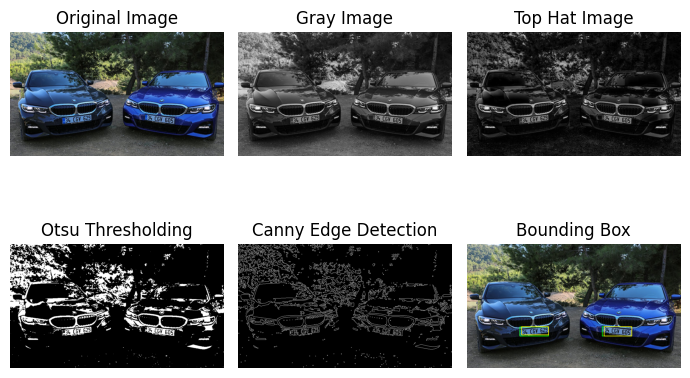

Otsu ROI (w, h, w/h): 1243, 311, 3.9967845659163985, Std Dev: 73.69
Canny ROI (w, h, w/h): 1180, 263, 4.486692015209125, Std Dev: 73.61
Overlap: 100.00%


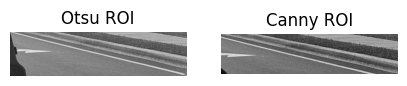

Otsu ROI (w, h, w/h): 1243, 311, 3.9967845659163985, Std Dev: 73.69
Canny ROI (w, h, w/h): 1244, 312, 3.9871794871794872, Std Dev: 73.69
Overlap: 100.00%


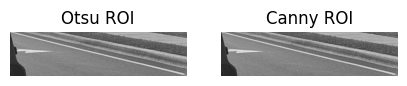

Otsu ROI (w, h, w/h): 1251, 293, 4.26962457337884, Std Dev: 73.65
Canny ROI (w, h, w/h): 1180, 263, 4.486692015209125, Std Dev: 73.61
Overlap: 100.00%


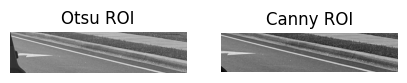

Otsu ROI (w, h, w/h): 1251, 293, 4.26962457337884, Std Dev: 73.65
Canny ROI (w, h, w/h): 1244, 312, 3.9871794871794872, Std Dev: 73.69
Overlap: 89.60%


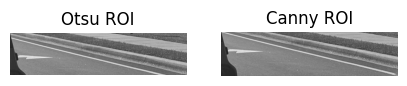

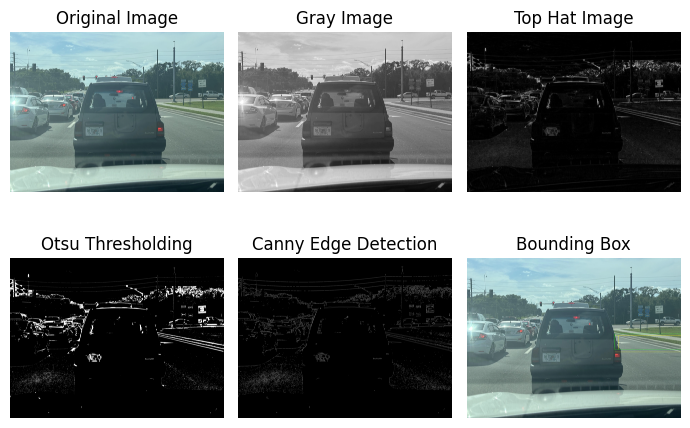

Otsu ROI (w, h, w/h): 199, 75, 2.6533333333333333, Std Dev: 73.91


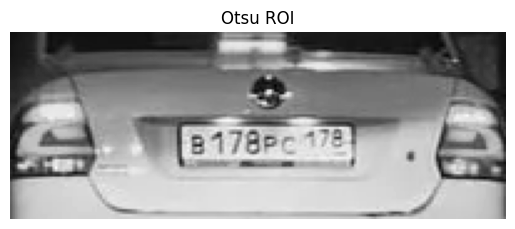

Canny ROI (w, h, w/h): 111, 37, 3.0, Std Dev: 0.00


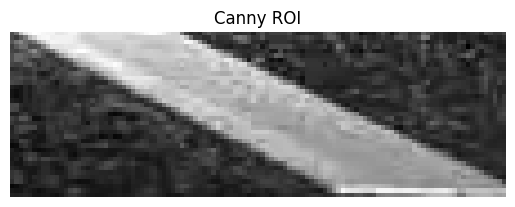

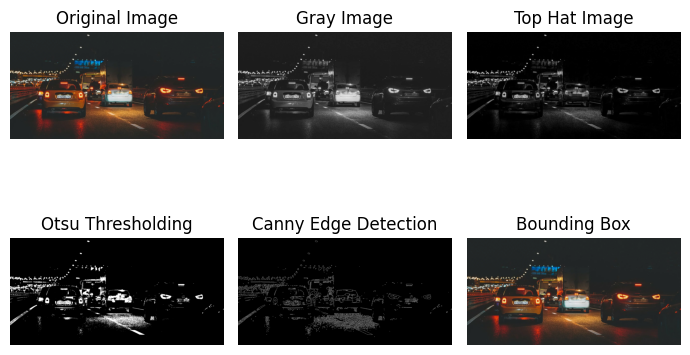

Otsu ROI (w, h, w/h): 271, 136, 1.9926470588235294, Std Dev: 73.69


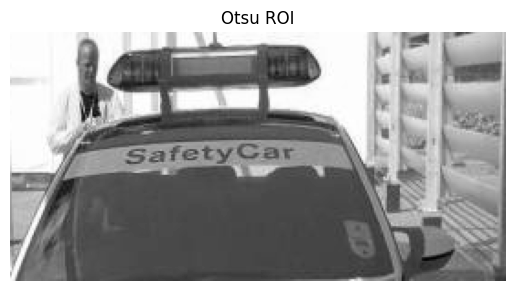

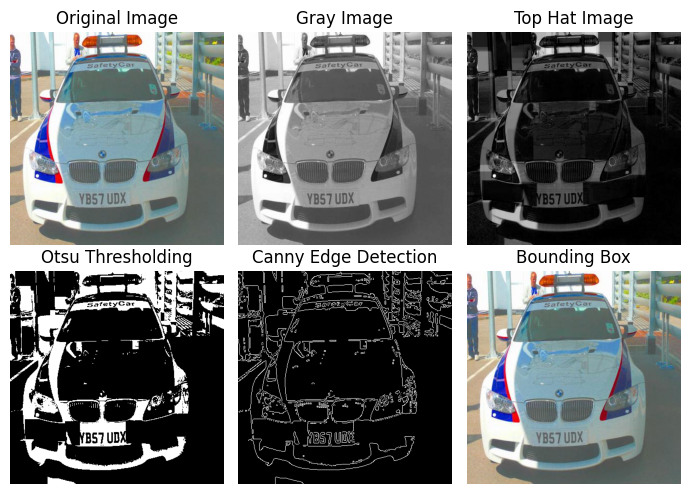

In [5]:
# Test görüntüleri listesi
images = ["plate_test_easy1.jpg", "plate_test_easy2.jpg", "plate_test_medium1.jpg", "plate_test_medium2.jpg", "plate_test_hard1.jpg", "plate_test_hard2.jpg"]
# Her görüntüyü sırayla test et
for i in images:
    trace_image_path = f"images/{i}"
    licence_plate_detection(trace_image_path)

## 2.  Algoritma Geliştirme Sürecinde Yapılan Testler ve Analizler

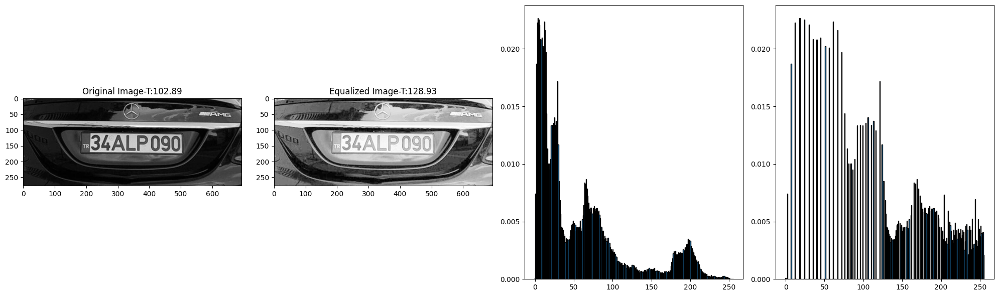

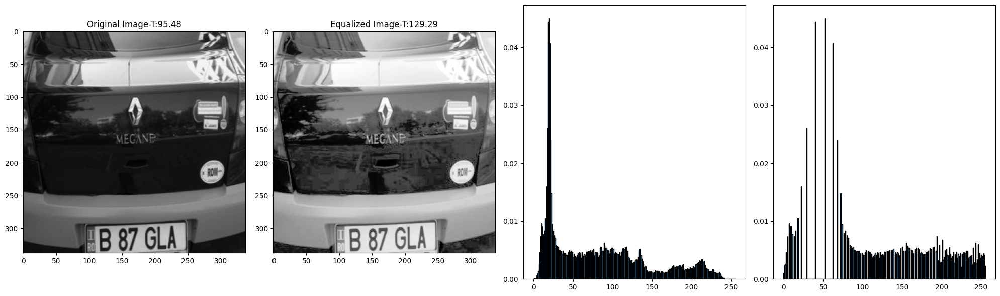

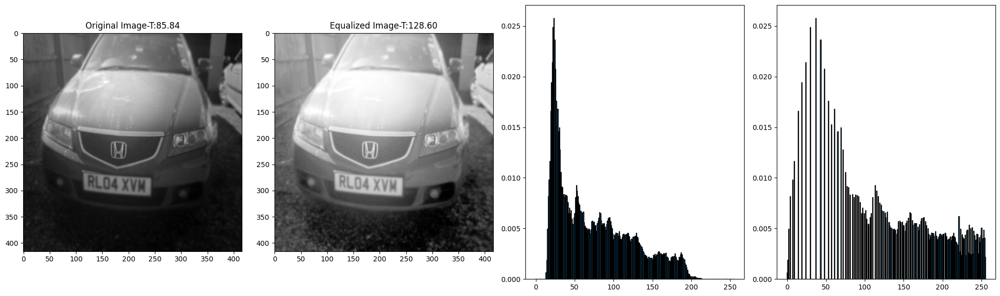

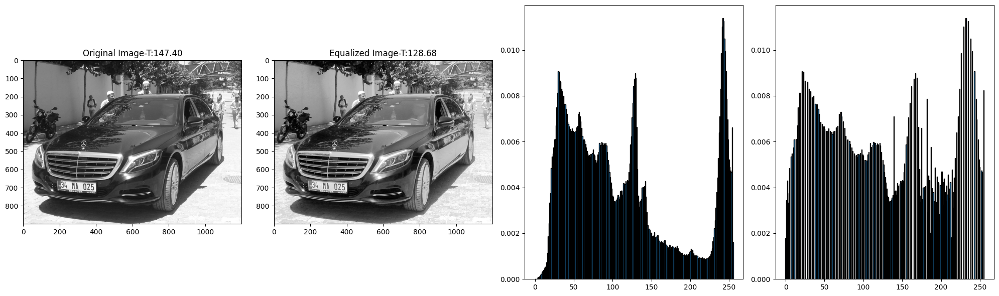

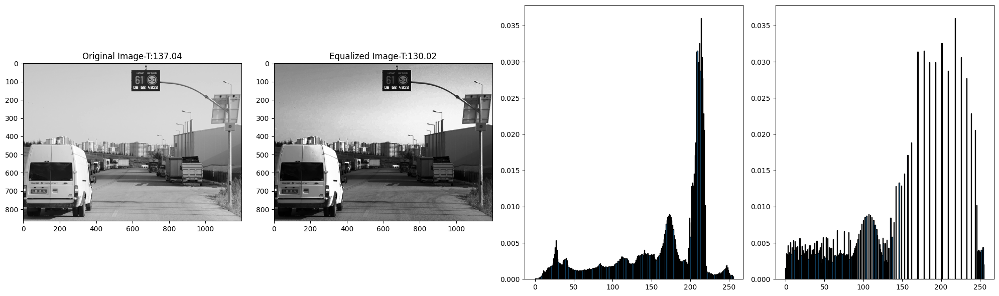

...

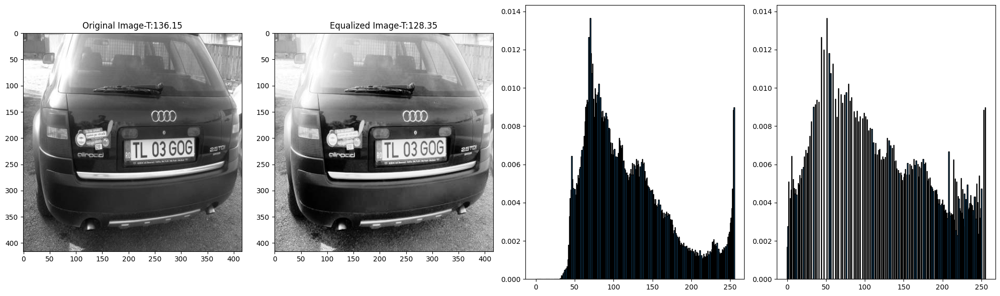

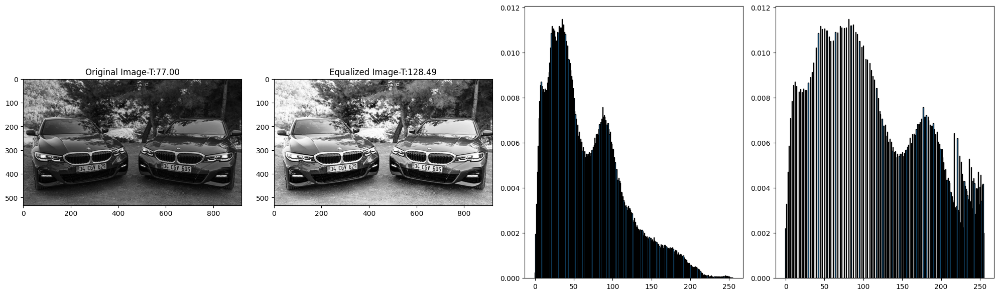

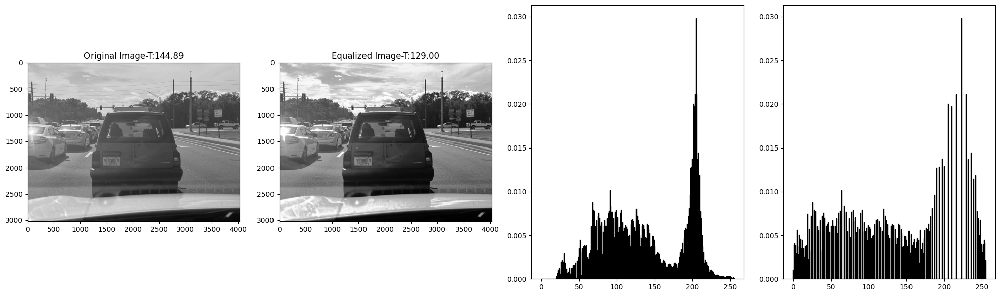

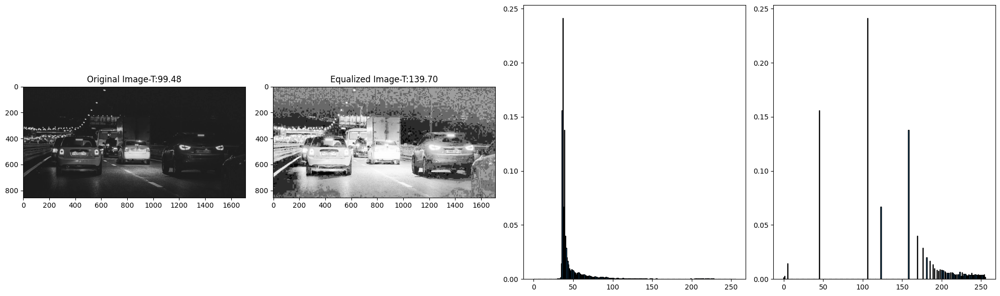

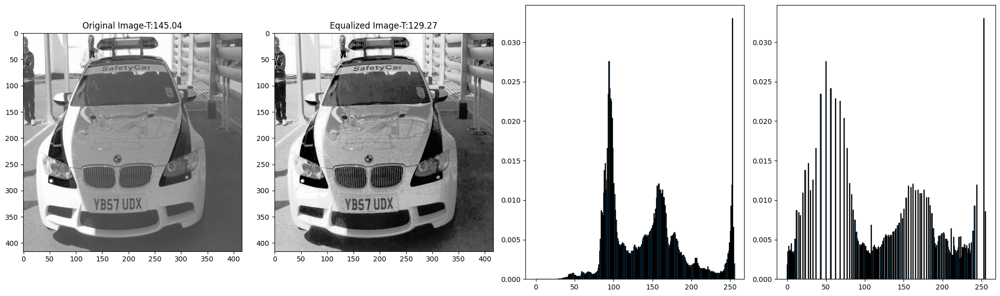

In [6]:
def get_opt_threshold(data, T):
    T_prv = 0
    T_new = T
    while np.abs(T_new-T_prv)>1:
        G1 = np.where(data<=T_new)
        G2 = np.where(data>T_new)
        m1 = np.sum(data[G1])/len(G1[0])
        m2 = np.sum(data[G2])/len(G2[0])
        T_prv = T_new
        T_new = (m1+m2)/2
    return T_new

def histogram_equalization(image):
    if len(image.shape) != 2:
        raise ValueError("Input image should be in grayscale")
    equalized_image = cv2.equalizeHist(image)
    return equalized_image

images = ["plate_traine_easy1.jpg", "plate_traine_easy2.jpg", "plate_traine_medium1.jpg", "plate_traine_medium2.jpg", "plate_traine_hard1.jpg", "plate_traine_hard2.jpg",
          "plate_test_easy1.jpg", "plate_test_easy2.jpg", "plate_test_medium1.jpg", "plate_test_medium2.jpg", "plate_test_hard1.jpg", "plate_test_hard2.jpg"]
data = [cv2.cvtColor(cv2.imread(f"images/{image}",cv2.IMREAD_COLOR),cv2.COLOR_BGR2GRAY) for image in images]

for image in data:
    equalized_image = histogram_equalization(image)
    T_org =get_opt_threshold(image, np.sum(image)/image.size)
    T_eq = get_opt_threshold(equalized_image, np.sum(equalized_image)/equalized_image.size)
    fig, ax = plt.subplots(1, 4, figsize=(20, 6))
    ax[0].imshow(image, cmap='gray')
    ax[0].set_title(f'Original Image-T:{T_org:.2f}')   
    ax[1].imshow(equalized_image, cmap='gray')
    ax[1].set_title(f'Equalized Image-T:{T_eq:.2f}')

    histogram, bins = np.histogram(image, bins=256, range=(0, 256))
    normalized_histogram = histogram / image.size
    ax[2].bar(bins[:-1], normalized_histogram, edgecolor='black')

    histogram, bins = np.histogram(equalized_image, bins=256, range=(0, 256))
    normalized_histogram = histogram / equalized_image.size
    ax[3].bar(bins[:-1], normalized_histogram, edgecolor='black')
    plt.tight_layout()
    plt.show()

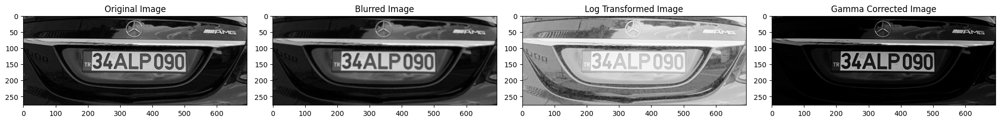

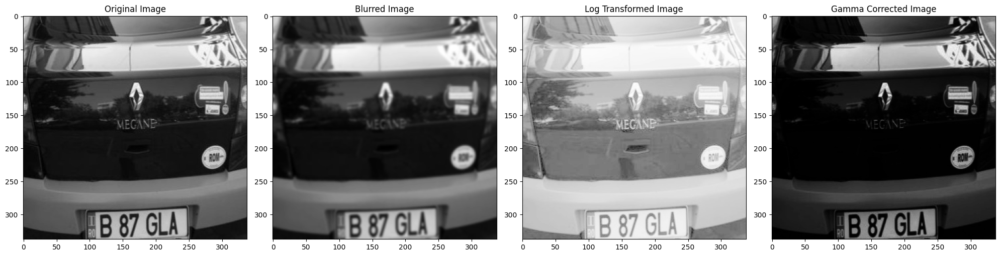

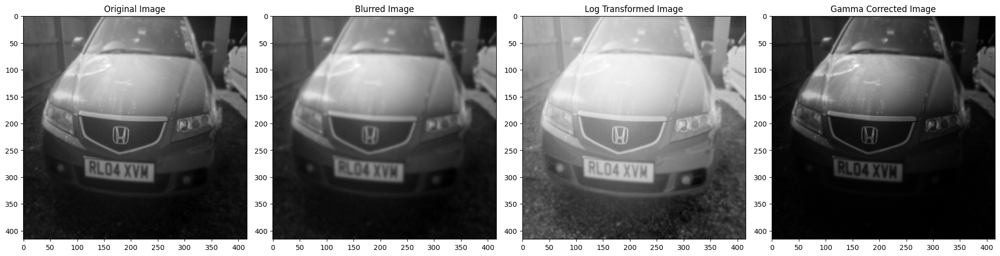

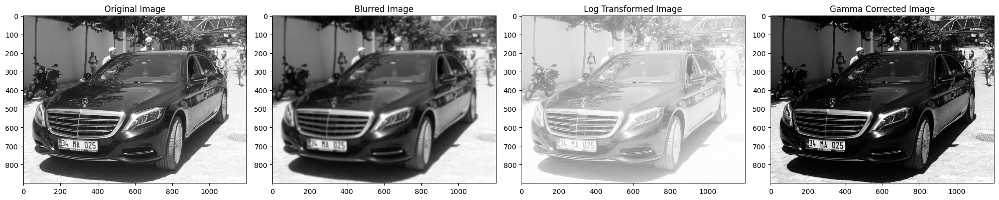

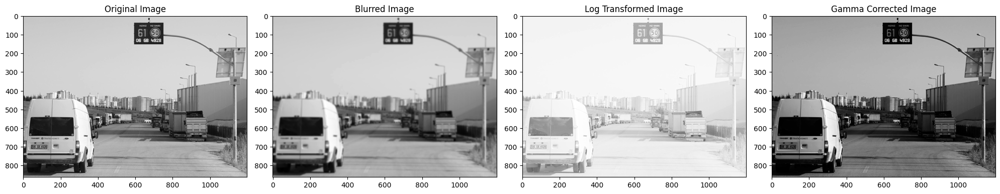

...

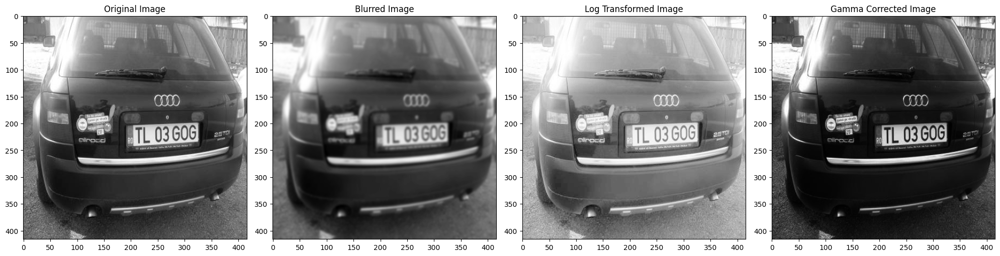

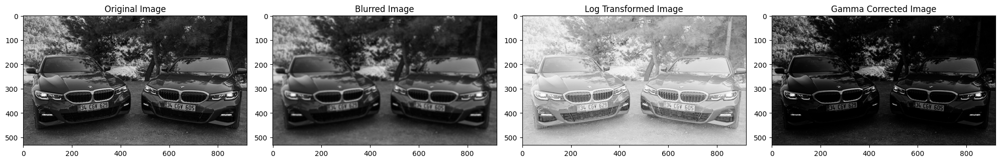

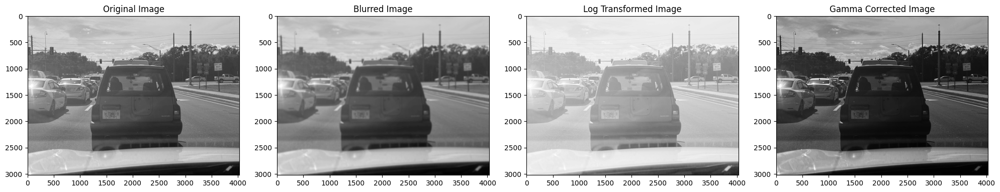

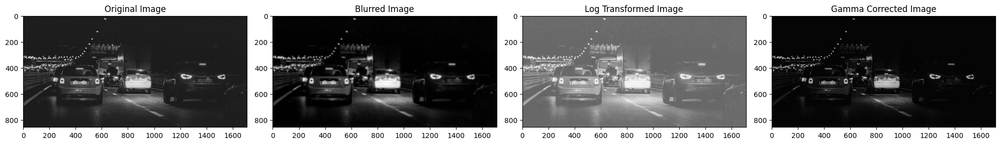

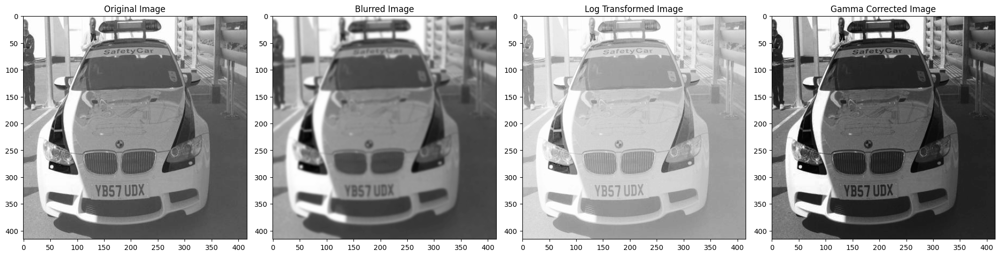

In [7]:
def gaussian_blur(image):
    height, width = image.shape[:2]
    kernel_size = max(3, min(height, width) // 100 * 2 + 1)  # Dinamik olarak kernel boyutunu belirle
    blurred_image = cv2.GaussianBlur(image, (kernel_size, kernel_size), 0)
    return blurred_image

def apply_log_transform(image):
    c = 255 / np.log(1 + np.max(image))
    log_transformed = c * np.log(1 + image.astype(np.float64))
    log_transformed = np.uint8(log_transformed)
    return log_transformed

def apply_power_law(image, gamma=1.0):
    normalized = image / 255.0
    gamma_corrected = np.power(normalized, gamma)
    gamma_corrected = np.uint8(gamma_corrected * 255)
    return gamma_corrected

images = ["plate_traine_easy1.jpg", "plate_traine_easy2.jpg", "plate_traine_medium1.jpg", "plate_traine_medium2.jpg", "plate_traine_hard1.jpg", "plate_traine_hard2.jpg",
          "plate_test_easy1.jpg", "plate_test_easy2.jpg", "plate_test_medium1.jpg", "plate_test_medium2.jpg", "plate_test_hard1.jpg", "plate_test_hard2.jpg"]
data = [cv2.cvtColor(cv2.imread(f"images/{image}",cv2.IMREAD_COLOR),cv2.COLOR_BGR2GRAY) for image in images]

for image in data:
    blurred_image = gaussian_blur(image)
    log_transformed = apply_log_transform(image)
    gamma_corrected = apply_power_law(image, 2)
    fig, ax = plt.subplots(1, 4, figsize=(20, 6))
    ax[0].imshow(image, cmap='gray')
    ax[0].set_title('Original Image')
    ax[1].imshow(blurred_image, cmap='gray')
    ax[1].set_title('Blurred Image')
    ax[2].imshow(log_transformed, cmap='gray')
    ax[2].set_title('Log Transformed Image')
    ax[3].imshow(gamma_corrected, cmap='gray')
    ax[3].set_title('Gamma Corrected Image')
    plt.tight_layout()
    plt.show()

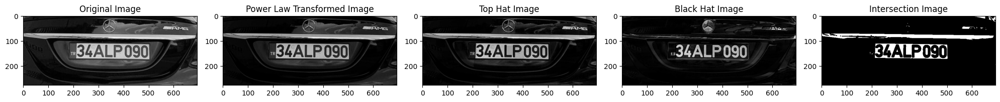

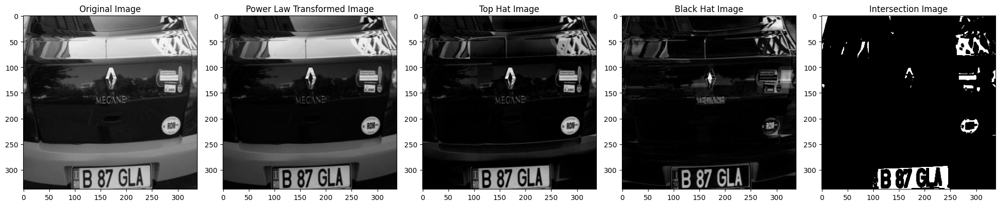

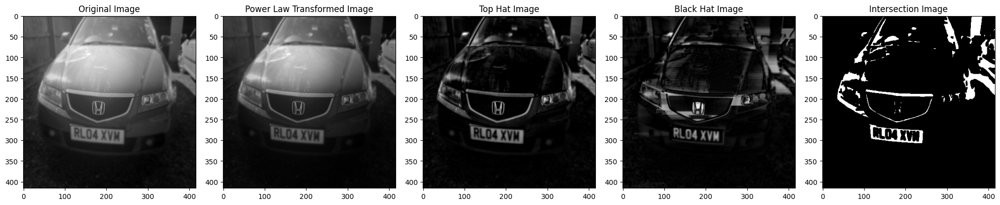

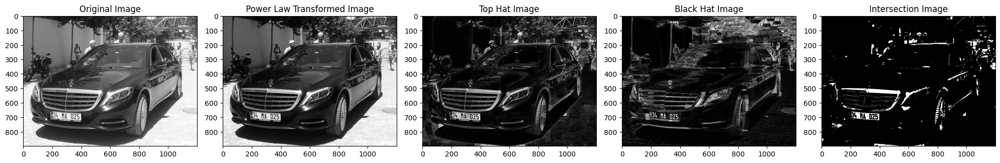

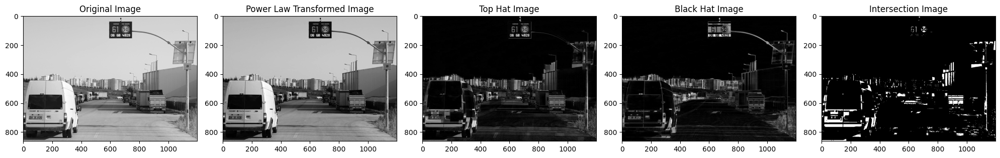

...

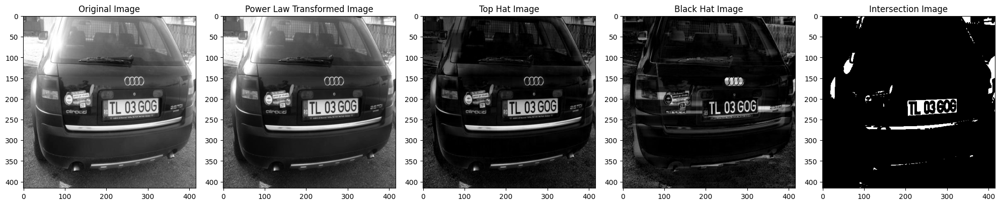

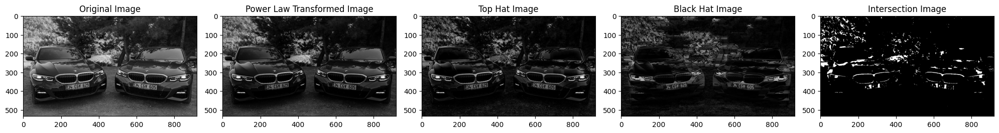

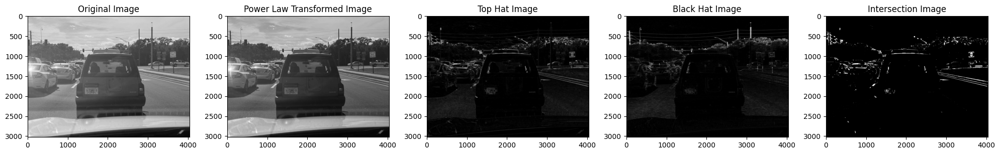

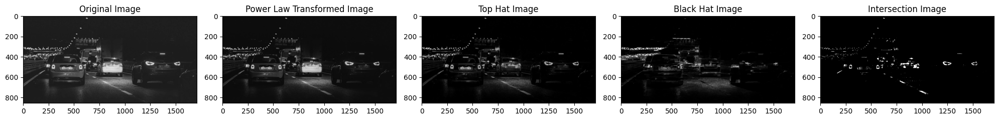

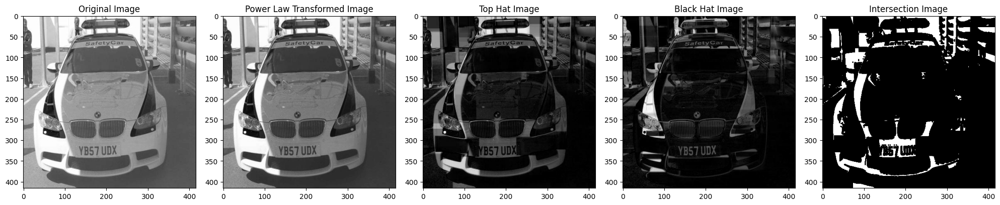

In [8]:
import cv2
import numpy as np
import skimage
import matplotlib.pyplot as plt
def apply_power_law(image, gamma=1.0):
    normalized = image / 255.0
    gamma_corrected = np.power(normalized, gamma)
    gamma_corrected = np.uint8(gamma_corrected * 255)
    return gamma_corrected

images = ["plate_traine_easy1.jpg", "plate_traine_easy2.jpg", "plate_traine_medium1.jpg", "plate_traine_medium2.jpg", "plate_traine_hard1.jpg", "plate_traine_hard2.jpg",
          "plate_test_easy1.jpg", "plate_test_easy2.jpg", "plate_test_medium1.jpg", "plate_test_medium2.jpg", "plate_test_hard1.jpg", "plate_test_hard2.jpg"]
data = [cv2.cvtColor(cv2.imread(f"images/{image}",cv2.IMREAD_COLOR),cv2.COLOR_BGR2GRAY) for image in images]

for i in range(len(data)):
    power_law_transformed = apply_power_law(data[i], gamma=1.5)

    kernel2 = cv2.getStructuringElement(cv2.MORPH_RECT, (40, 8))
    blackhat_image = cv2.morphologyEx(power_law_transformed, cv2.MORPH_BLACKHAT, kernel2)
    
    kernel1 = cv2.getStructuringElement(cv2.MORPH_RECT, (30, 30))
    tophat_image = cv2.morphologyEx(power_law_transformed, cv2.MORPH_TOPHAT, kernel1)

    _, thresholded_image1 = cv2.threshold(tophat_image, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    _, thresholded_image2 = cv2.threshold(blackhat_image, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    

    intersection = cv2.bitwise_and(thresholded_image1, skimage.util.invert(thresholded_image2))
    
    kernel3 = cv2.getStructuringElement(cv2.MORPH_RECT, (3, 3))
    intersection = cv2.morphologyEx(intersection, cv2.MORPH_ERODE, kernel3)

    fig, ax = plt.subplots(1, 5, figsize=(20, 6))
    ax[0].imshow(data[i], cmap='gray')
    ax[0].set_title('Original Image')
    ax[1].imshow(power_law_transformed, cmap='gray')
    ax[1].set_title('Power Law Transformed Image')
    ax[2].imshow(tophat_image, cmap='gray')
    ax[2].set_title('Top Hat Image')
    ax[3].imshow(blackhat_image, cmap='gray')
    ax[3].set_title('Black Hat Image')
    ax[4].imshow(intersection, cmap='gray')
    ax[4].set_title('Intersection Image')
    plt.tight_layout()
    plt.show()

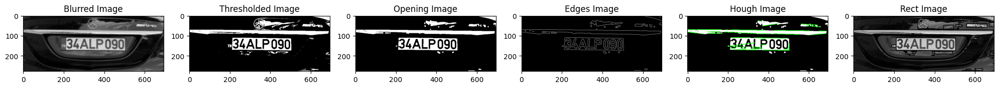

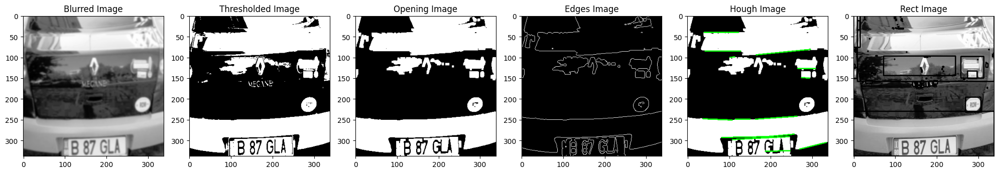

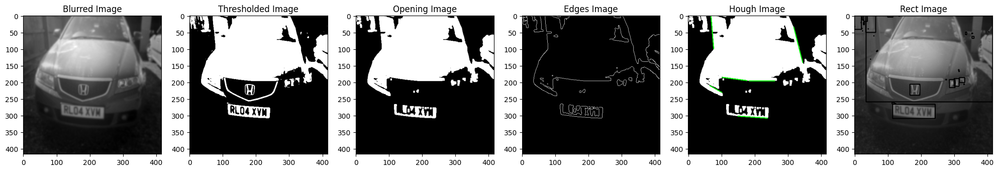

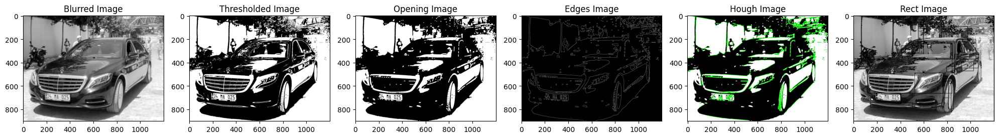

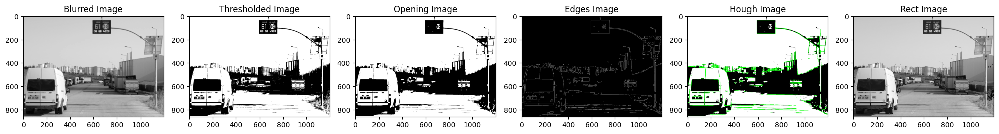

...

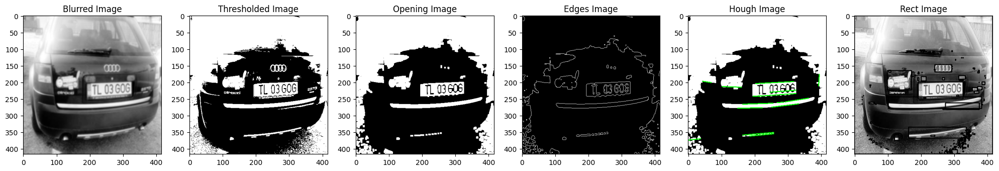

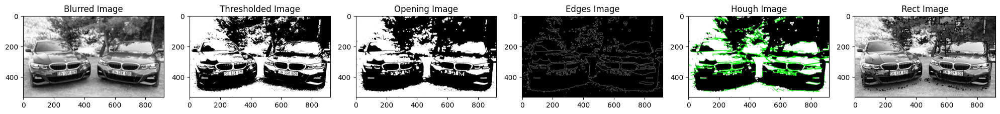

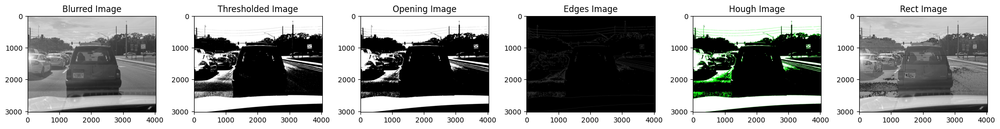

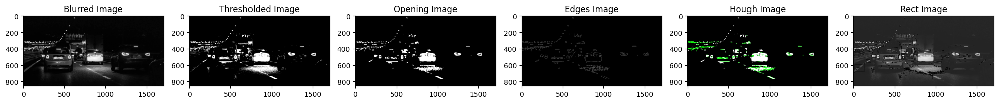

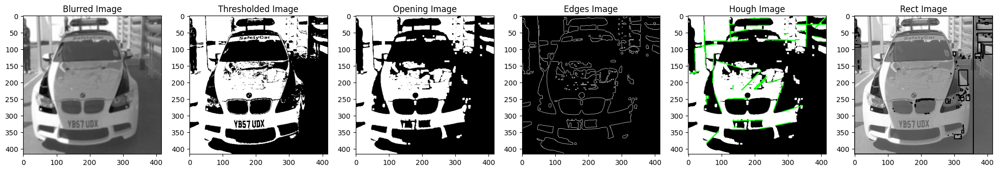

In [9]:
rois = []
for i in range(len(data)):
    fig, ax = plt.subplots(1, 6, figsize=(20, 10))
    if i in [1, 3, 5, 6, 7, 8]:
        data[i] = cv2.equalizeHist(data[i])
        
    blurred_image = cv2.GaussianBlur(data[i], (7, 7), 0)
    _, thresholded_image = cv2.threshold(data[i], 127, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (5, 5))
    opening_image = cv2.morphologyEx(thresholded_image, cv2.MORPH_OPEN, kernel)

    edges = cv2.Canny(opening_image, 50, 150, apertureSize=3)
    lines = cv2.HoughLinesP(edges, 1, np.pi / 180, threshold=50, minLineLength=2, maxLineGap=15)
    hough_image = cv2.cvtColor(opening_image, cv2.COLOR_GRAY2BGR)
    if lines is not None:
        for line in lines:
            x1, y1, x2, y2 = line[0]
            cv2.line(hough_image, (x1, y1), (x2, y2), (0, 255, 0), 2)

    contours, _ = cv2.findContours(thresholded_image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    rects = [cv2.boundingRect(contour) for contour in contours]
    rect_image = np.copy(data[i])
    
    rois.append([])
    for rect in rects:
        x, y, w, h = rect
        roi = thresholded_image[y:y+h, x:x+w]
        num_labels, labels = cv2.connectedComponents(skimage.util.invert(roi), connectivity=8)
        cv2.rectangle(rect_image, (x, y), (x + w, y + h), (0, 255, 0), 2)
        if num_labels:
            rois[i].append(roi)
    rect_image = cv2.cvtColor(rect_image, cv2.COLOR_BGR2RGB)

    ax[0].imshow(blurred_image, cmap='gray'),       ax[0].set_title('Blurred Image')
    ax[1].imshow(thresholded_image, cmap='gray'),   ax[1].set_title('Thresholded Image')
    ax[2].imshow(opening_image, cmap='gray'),       ax[2].set_title('Opening Image')
    ax[3].imshow(edges, cmap='gray'),               ax[3].set_title('Edges Image')
    ax[4].imshow(hough_image),                      ax[4].set_title('Hough Image')
    ax[5].imshow(rect_image),                       ax[5].set_title('Rect Image')
    fig.tight_layout()
    plt.show()

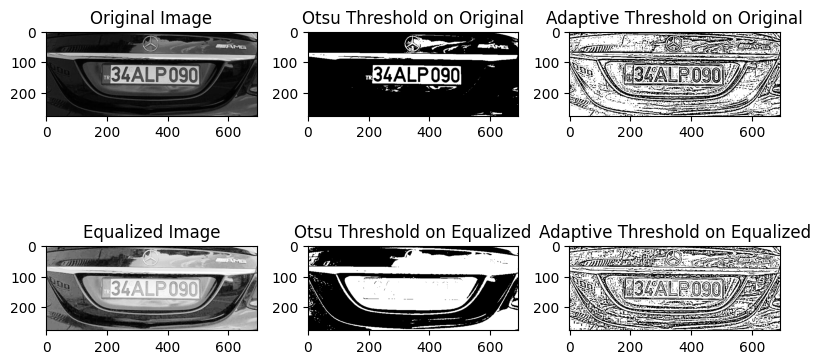

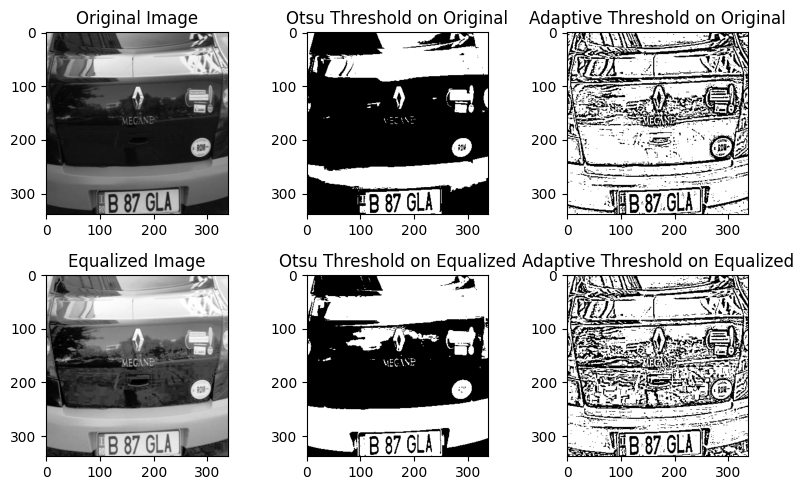

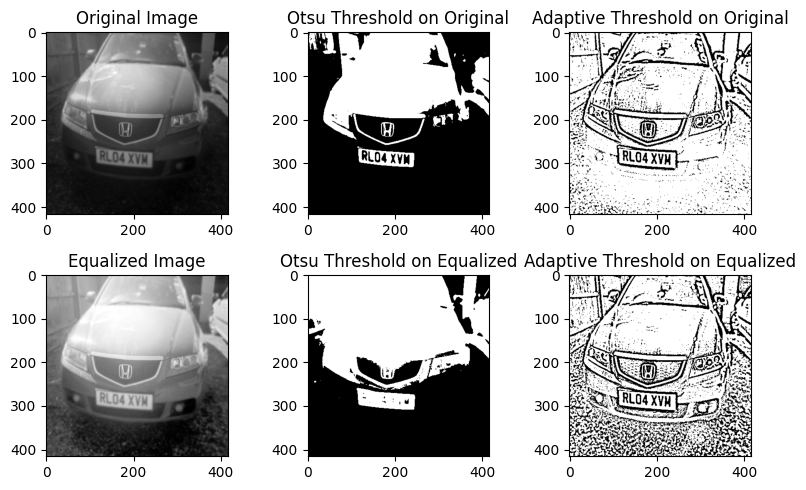

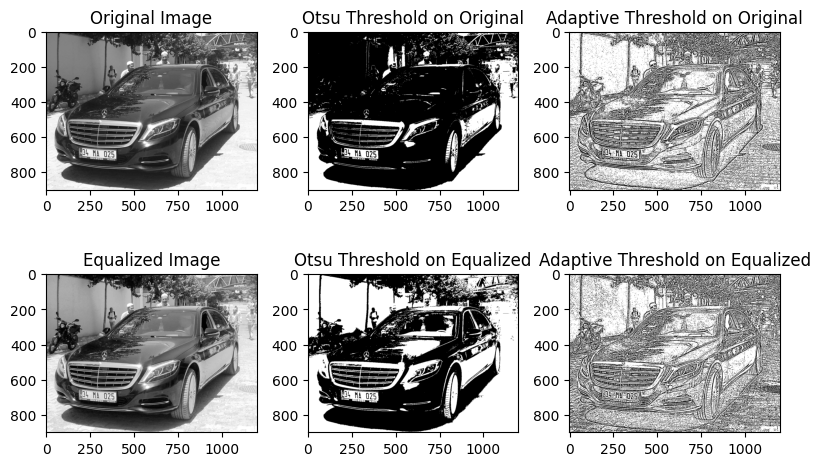

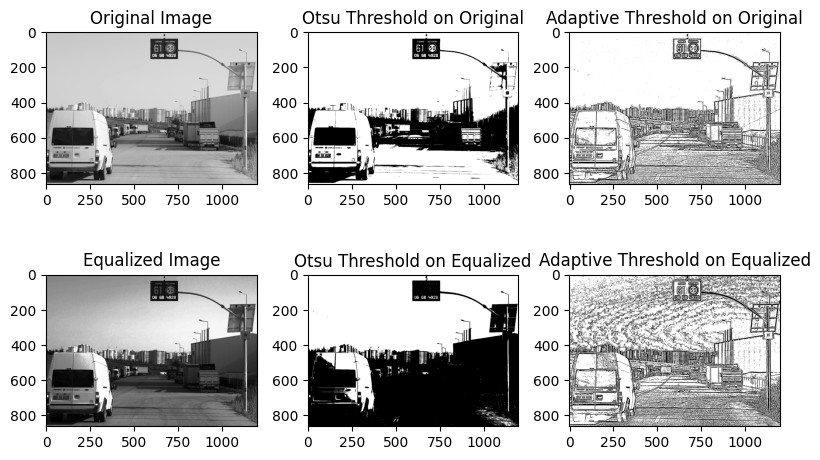

...

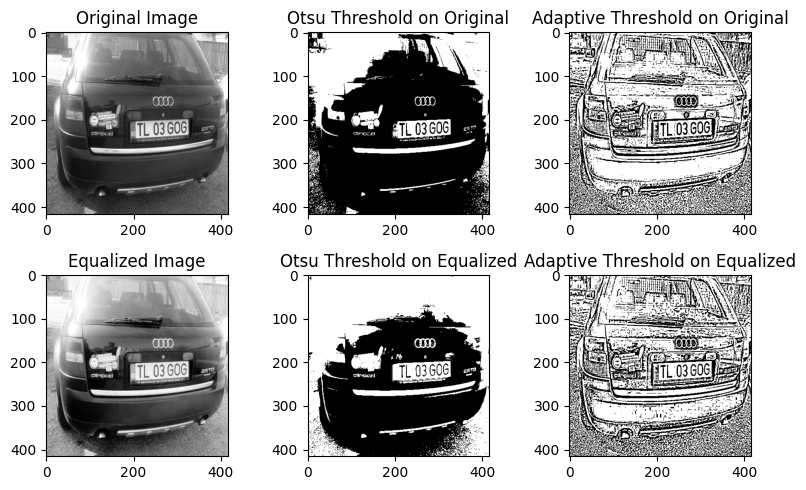

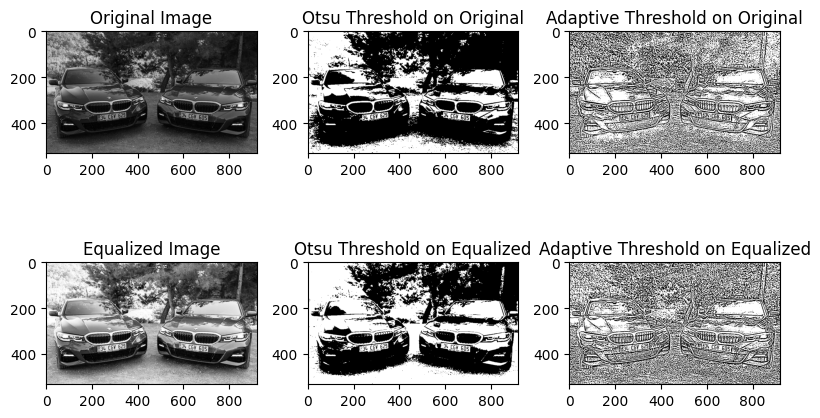

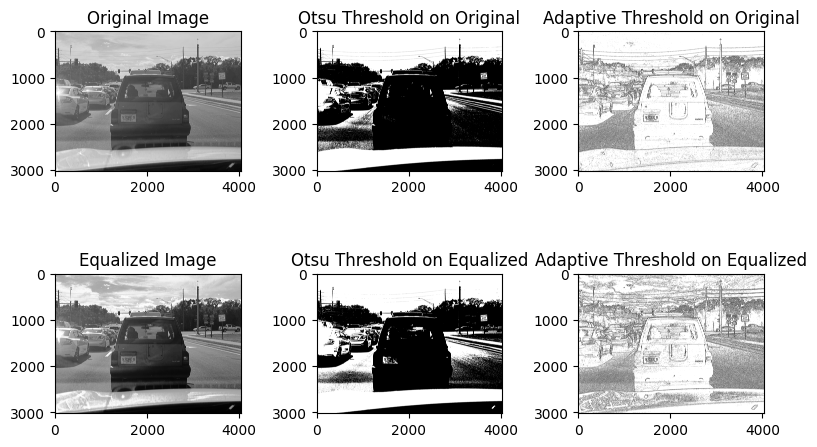

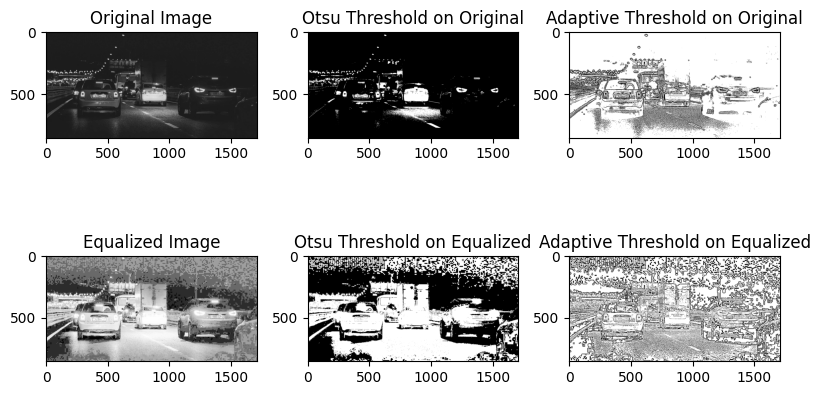

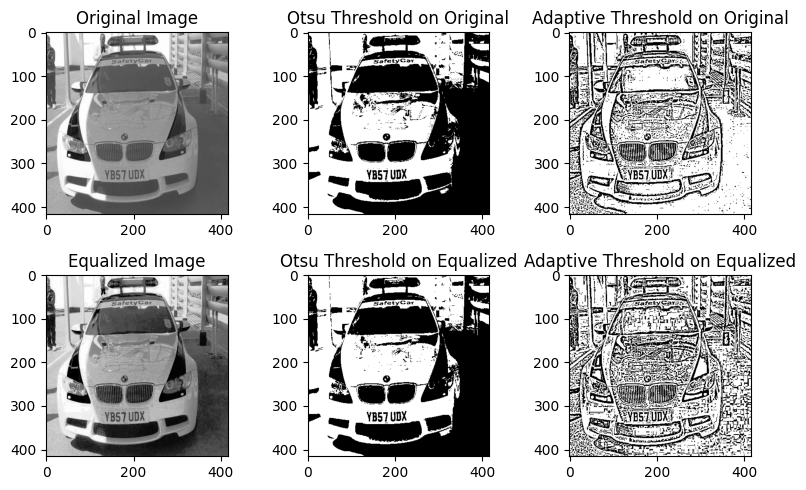

In [10]:
import cv2
import numpy as np
import skimage
import matplotlib.pyplot as plt
def apply_power_law(image, gamma=1.0):
    normalized = image / 255.0
    gamma_corrected = np.power(normalized, gamma)
    gamma_corrected = np.uint8(gamma_corrected * 255)
    return gamma_corrected

images = ["plate_traine_easy1.jpg", "plate_traine_easy2.jpg", "plate_traine_medium1.jpg", "plate_traine_medium2.jpg", "plate_traine_hard1.jpg", "plate_traine_hard2.jpg",
          "plate_test_easy1.jpg", "plate_test_easy2.jpg", "plate_test_medium1.jpg", "plate_test_medium2.jpg", "plate_test_hard1.jpg", "plate_test_hard2.jpg"]
data = [cv2.cvtColor(cv2.imread(f"images/{image}",cv2.IMREAD_COLOR),cv2.COLOR_BGR2GRAY) for image in images]

for i in range(len(data)):
    # Otsu thresholding on original and equalized images
    _, otsu_thresh_orig = cv2.threshold(data[i], 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    equalized_image = cv2.equalizeHist(data[i])
    _, otsu_thresh_eq = cv2.threshold(equalized_image, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    # Adaptive thresholding on original and equalized images
    adaptive_thresh_orig = cv2.adaptiveThreshold(data[i], 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 11, 2)
    adaptive_thresh_eq = cv2.adaptiveThreshold(equalized_image, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 11, 2)

    fig, ax = plt.subplots(2, 3, figsize=(8, 5))
    ax[0, 0].imshow(data[i], cmap='gray'),                 ax[0, 0].set_title('Original Image')
    ax[0, 1].imshow(otsu_thresh_orig, cmap='gray'),        ax[0, 1].set_title('Otsu Threshold on Original')
    ax[0, 2].imshow(adaptive_thresh_orig, cmap='gray'),    ax[0, 2].set_title('Adaptive Threshold on Original')
    ax[1, 0].imshow(equalized_image, cmap='gray'),         ax[1, 0].set_title('Equalized Image')
    ax[1, 1].imshow(otsu_thresh_eq, cmap='gray'),          ax[1, 1].set_title('Otsu Threshold on Equalized')
    ax[1, 2].imshow(adaptive_thresh_eq, cmap='gray'),      ax[1, 2].set_title('Adaptive Threshold on Equalized')
    plt.tight_layout()
    plt.show()